<h1> Prerequisites</h1>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


<h1> Libraries </h1>

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import os
import random

In [ ]:
length = 7502

common_path = "/content/drive/MyDrive/Townhall_dataset/OxfordTownCentre"

csv_file = common_path + "/" + os.listdir(common_path)[1]
video_file = common_path + "/" + os.listdir(common_path)[2]

print("Declaring path to raw data :")
print("="*50)
print("common_path :",common_path)
print("csv_file    :",csv_file)
print("video_file  :",video_file)

print()

train = common_path + "/" + "train"
test = common_path + "/" + "test"

#split Ratio
print("Split Ratio :")
print("="*50)
print("train path : {}".format(train))
print("test path  : {}".format(test))
print()
print("-Note")
print("--train : {} that is {} % of the whole data".format(len(os.listdir(train)) , len(os.listdir(train)) / length))
print("--test  : {} that is {} % of the whole data".format(len(os.listdir(test)) , len(os.listdir(test)) / length) )

print()
xml_path = common_path + "/" + "xmls"

#3076 , 3082 , 3086 are missing,so removed it from the train files.
print("="*50)
print("xml_path : {}".format(xml_path))
print()
print("-Note")
print("--No. of total XML files are {} == no. of train files.".format(len(os.listdir(xml_path))))

Declaring path to raw data :
common_path : /content/drive/MyDrive/Townhall_dataset/OxfordTownCentre
csv_file    : /content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/TownCentre-groundtruth.top
video_file  : /content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/TownCentreXVID.mp4

Split Ratio :
train path : /content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/train
test path  : /content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/test

-Note
--train : 3087 that is 0.41149026926153026 % of the whole data
--test  : 4412 that is 0.5881098373766995 % of the whole data

xml_path : /content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/xmls

-Note
--No. of total XML files are 3087 == no. of train files.


<h1> Training </h1>

In [ ]:
!git clone https://github.com/tensorflow/models.git

fatal: destination path 'models' already exists and is not an empty directory.


In [ ]:
%cd /content/models/research/
!protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

/content/models/research
Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-cp37-none-any.whl size=1624271 sha256=e7ba77bf6ad350b39f985819fa223f7192041b77e9339b31e05d56e4e0c1e282
  Stored in directory: /tmp/pip-ephem-wheel-cache-vnxauff7/wheels/94/49/4b/39b051683087a22ef7e80ec52152a27249d1a644ccf4e442ea
Successfully built object-detection
  Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


Running the model builder test

In [ ]:
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

2021-03-01 08:31:26.517448: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Running tests under Python 3.7.10: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2021-03-01 08:31:29.152189: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-03-01 08:31:29.153185: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-03-01 08:31:29.216838: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-03-01 08:31:29.217453: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize:

<h1> Loading Mobile-Net-SSD model with predefined coco weights </h1>

In [ ]:
%cd /content
!wget http://download.tensorflow.org/models/object_detection/classification/tf2/20200710/mobilenet_v2.tar.gz
!tar -xvf mobilenet_v2.tar.gz
!rm mobilenet_v2.tar.gz

/content
--2021-03-01 10:05:49--  http://download.tensorflow.org/models/object_detection/classification/tf2/20200710/mobilenet_v2.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 64.233.189.128, 2404:6800:4008:c01::80
Connecting to download.tensorflow.org (download.tensorflow.org)|64.233.189.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8404070 (8.0M) [application/x-tar]
Saving to: ‘mobilenet_v2.tar.gz’

mobilenet_v2.tar.gz 100%[===================>]   8.01M  --.-KB/s    in 0.05s   

2021-03-01 10:05:49 (153 MB/s) - ‘mobilenet_v2.tar.gz’ saved [8404070/8404070]

mobilenet_v2/
mobilenet_v2/mobilenet_v2.ckpt-1.index
mobilenet_v2/checkpoint
mobilenet_v2/mobilenet_v2.ckpt-1.data-00001-of-00002
mobilenet_v2/mobilenet_v2.ckpt-1.data-00000-of-00002


In [ ]:
!wget https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_320x320_coco17_tpu-8.config
!mv ssd_mobilenet_v2_320x320_coco17_tpu-8.config mobilenet_v2.config

--2021-03-01 10:05:57--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_320x320_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4484 (4.4K) [text/plain]
Saving to: ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.config’

ssd_mobilenet_v2_32 100%[===================>]   4.38K  --.-KB/s    in 0s      

2021-03-01 10:05:58 (86.3 MB/s) - ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.config’ saved [4484/4484]



<h1> Defining Training Params </h1>

In [ ]:
num_classes = 1
batch_size = 16
num_steps = 6000
num_eval_steps = 1000

train_record_path = common_path + "/train.record"
test_record_path = common_path + "/val.record"
model_dir = '/content/training/'
labelmap_path = '/content/label_map.pbtxt'

pipeline_config_path = 'mobilenet_v2.config'
fine_tune_checkpoint = '/content/mobilenet_v2/mobilenet_v2.ckpt-1'

#### Editing config file

The next cell is modification of the code available at [4].

In [ ]:
import re

with open(pipeline_config_path) as f:
    config = f.read()

with open(pipeline_config_path, 'w') as f:

  # Set labelmap path
  config = re.sub('label_map_path: ".*?"', 
  'label_map_path: "{}"'.format(labelmap_path), config)
  
  # Set fine_tune_checkpoint path
  config = re.sub('fine_tune_checkpoint: ".*?"',
                  'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint),
                  config)
  
  # Set train tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 
                  'input_path: "{}"'.format(train_record_path), config)
  
  # Set test tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 
                  'input_path: "{}"'.format(test_record_path), config)
  
  # Set number of classes.
  config = re.sub('num_classes: [0-9]+',
                  'num_classes: {}'.format(num_classes), config)
  
  # Set batch size
  config = re.sub('batch_size: [0-9]+',
                  'batch_size: {}'.format(batch_size), config)
  
  # Set training steps
  config = re.sub('num_steps: [0-9]+',
                  'num_steps: {}'.format(num_steps), config)
  
  f.write(config)

<h1> Training </h1>

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2021-03-01 08:33:00.561656: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-03-01 08:33:02.764540: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-03-01 08:33:02.765293: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-03-01 08:33:02.779650: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-03-01 08:33:02.780256: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2021-03-01 08:33:02.780290: I tensorflow/stream_executor/platform/def

### Validation

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir}           ##This is passed to run ONLY EVALUATION

2021-03-01 08:59:36.882413: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
W0301 08:59:39.058230 140531786172288 model_lib_v2.py:1043] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0301 08:59:39.058408 140531786172288 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0301 08:59:39.058482 140531786172288 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0301 08:59:39.058538 140531786172288 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0301 08:59:39.058613 140531786172288 model_lib_v2.py:1058] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2021-03-01 08:59:39.065024: I tensorflow/compiler/jit/xla

### Training and validation Metrics 

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/'

<IPython.core.display.Javascript object>

### Saving the model.



In [ ]:
output_directory = 'inference_graph'

!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {model_dir} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_config_path}

2021-03-01 09:04:52.564804: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-03-01 09:04:54.543374: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-03-01 09:04:54.544238: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-03-01 09:04:54.558120: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-03-01 09:04:54.558690: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2021-03-01 09:04:54.558719: I tensorflow/stream_executor/platform/def

##### Downloading weights

In [ ]:
!zip -r /content/saved_model.zip /content/inference_graph/saved_model/

  adding: content/inference_graph/saved_model/ (stored 0%)
  adding: content/inference_graph/saved_model/variables/ (stored 0%)
  adding: content/inference_graph/saved_model/variables/variables.data-00000-of-00001 (deflated 8%)
  adding: content/inference_graph/saved_model/variables/variables.index (deflated 76%)
  adding: content/inference_graph/saved_model/saved_model.pb (deflated 93%)
  adding: content/inference_graph/saved_model/assets/ (stored 0%)


In [ ]:
from google.colab import files
files.download("/content/saved_model.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

###  Testing the trained model

Based on [Object Detection API Demo](https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/object_detection_tutorial.ipynb) and [Inference from saved model tf2 colab](https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/inference_from_saved_model_tf2_colab.ipynb).

In [ ]:
!wget https://raw.githubusercontent.com/hugozanini/object-detection/master/inferenceutils.py
from inferenceutils import *

--2021-03-01 10:02:00--  https://raw.githubusercontent.com/hugozanini/object-detection/master/inferenceutils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2219 (2.2K) [text/plain]
Saving to: ‘inferenceutils.py.1’

inferenceutils.py.1 100%[===================>]   2.17K  --.-KB/s    in 0s      

2021-03-01 10:02:00 (42.8 MB/s) - ‘inferenceutils.py.1’ saved [2219/2219]



##### Loading the model

In [ ]:
output_directory = 'inference_graph/'

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'/content/{output_directory}/saved_model')

In [ ]:
model

<tensorflow.python.saved_model.load.Loader._recreate_base_user_object.<locals>._UserObject at 0x7f1370bf6250>

In [ ]:
import random

test_images = [test + "/" + i for i in random.sample(os.listdir(test), 5)]
test_images

['/content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/test/5358.jpg',
 '/content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/test/4938.jpg',
 '/content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/test/6964.jpg',
 '/content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/test/3723.jpg',
 '/content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/test/7024.jpg']

image 1


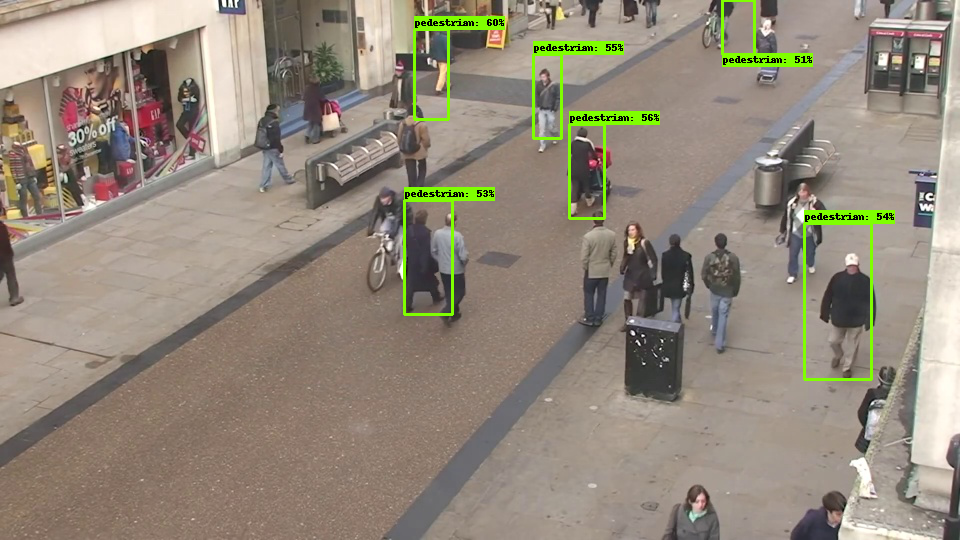

image 2


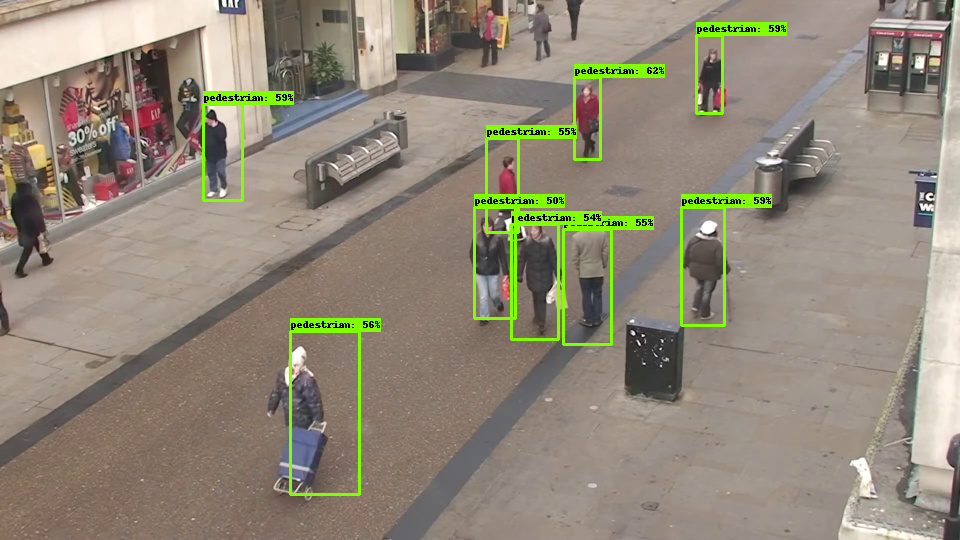

image 3


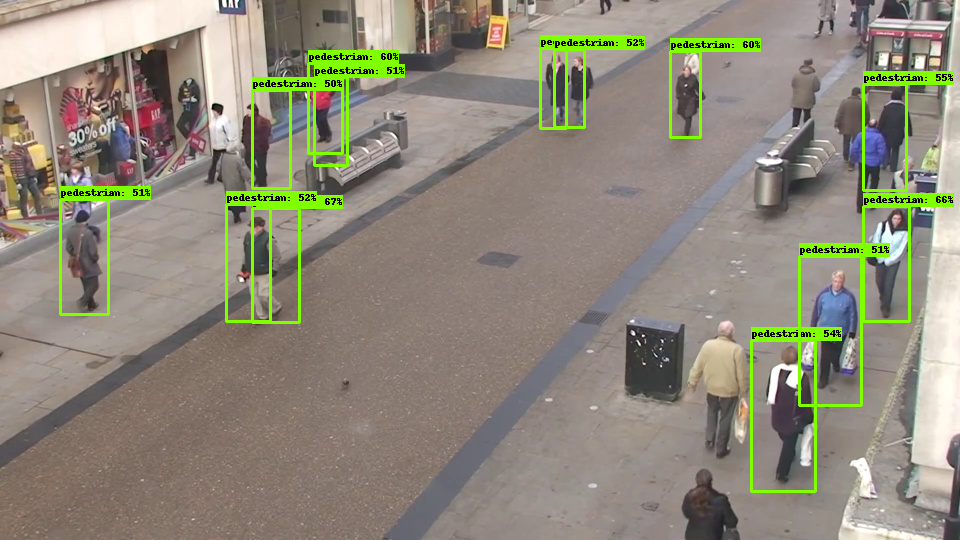

image 4


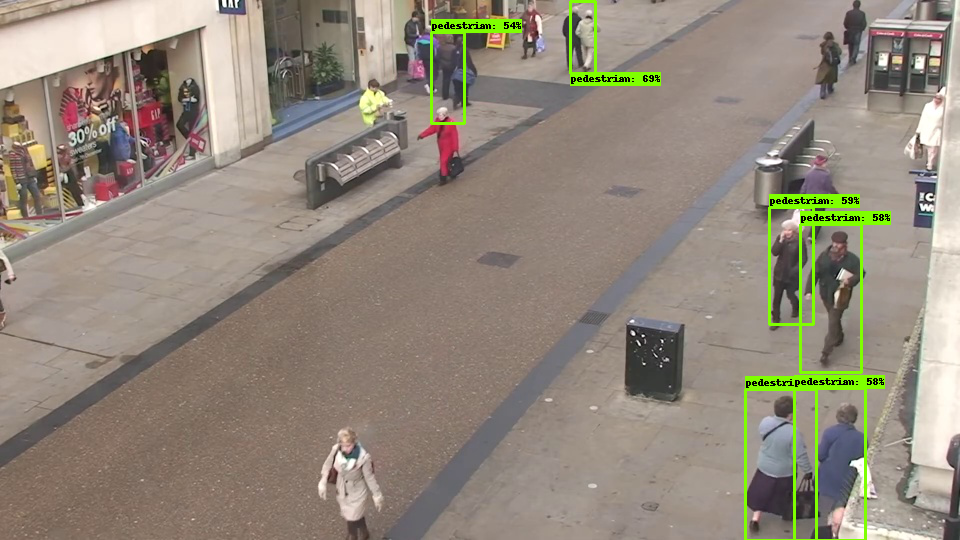

image 5


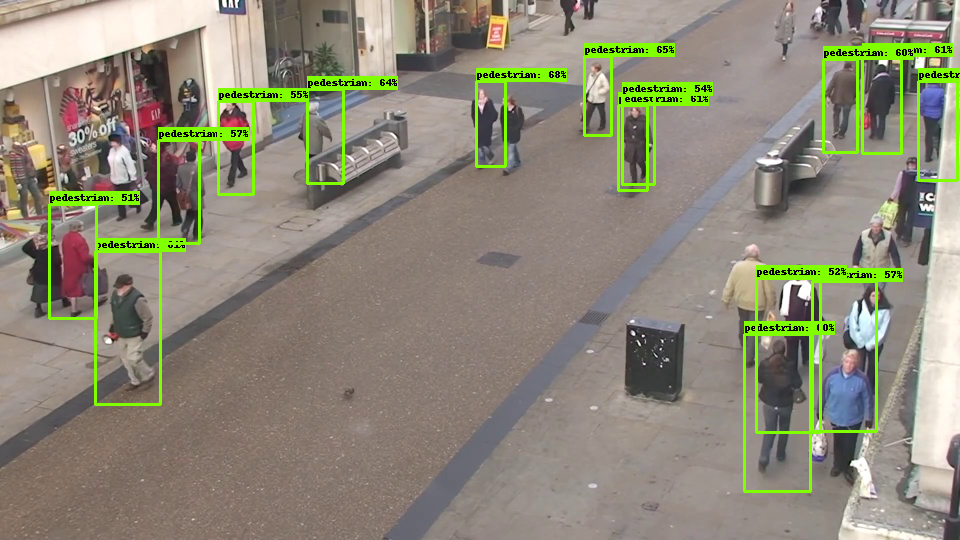

In [ ]:
i = 0
for image_name in test_images:
  print("="*100)
  print("image {}".format(i + 1))
  print("="*100)
  image_np = load_image_into_numpy_array(image_name)
  output_dict = run_inference_for_single_image(model, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=3)
  display(Image.fromarray(image_np))
  i = i + 1

<h1> MAP </h1>

In [ ]:
test_images = [train + "/" + i for i in random.sample(os.listdir(train), 30)]

In [ ]:
def get_map(maps):
    return sum(maps) / len(maps)
    

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
maps = []
for image_name in tqdm(test_images):
  image_np = load_image_into_numpy_array(image_name)
  output_dict = run_inference_for_single_image(model, image_np)
  maps.append(get_map( output_dict['detection_scores']))

maps

100%|██████████| 30/30 [00:43<00:00,  1.45s/it]


[0.18098383411765098,
 0.20825022369623183,
 0.16290064685046673,
 0.20184385955333708,
 0.28221067853271964,
 0.24166934341192245,
 0.22720165356993674,
 0.26819934517145155,
 0.2844222117960453,
 0.22047634929418564,
 0.24291367180645465,
 0.22022649981081485,
 0.21598059192299843,
 0.29245769016444684,
 0.2758069283515215,
 0.21288558170199395,
 0.2964972798526287,
 0.2920992238819599,
 0.25491711027920244,
 0.22457461409270763,
 0.21146872706711292,
 0.2188791798055172,
 0.2846847757697105,
 0.23796659156680108,
 0.229725276902318,
 0.221589380428195,
 0.252626666277647,
 0.21363136880099773,
 0.22280752696096898,
 0.16319342605769635]

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


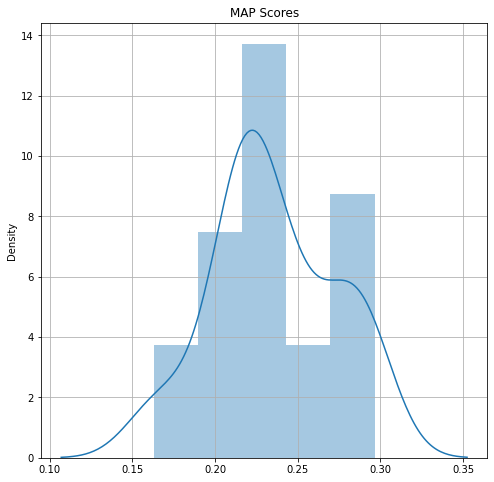

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

maps = [0.18098383411765098,
 0.20825022369623183,
 0.16290064685046673,
 0.20184385955333708,
 0.28221067853271964,
 0.24166934341192245,
 0.22720165356993674,
 0.26819934517145155,
 0.2844222117960453,
 0.22047634929418564,
 0.24291367180645465,
 0.22022649981081485,
 0.21598059192299843,
 0.29245769016444684,
 0.2758069283515215,
 0.21288558170199395,
 0.2964972798526287,
 0.2920992238819599,
 0.25491711027920244,
 0.22457461409270763,
 0.21146872706711292,
 0.2188791798055172,
 0.2846847757697105,
 0.23796659156680108,
 0.229725276902318,
 0.221589380428195,
 0.252626666277647,
 0.21363136880099773,
 0.22280752696096898,
 0.16319342605769635]

plt.figure(figsize=(8,8))

plt.title("MAP Scores")
sns.distplot(maps)
plt.grid(True)
plt.show()

<h1> Training wiith YOLO </h1>

In [ ]:
pip install tensorflow==1.13.2

     |████████████████████████████████| 92.7MB 62kB/s 
     |████████████████████████████████| 3.2MB 46.4MB/s 
     |████████████████████████████████| 51kB 6.3MB/s 
     |████████████████████████████████| 368kB 37.0MB/s 
  Found existing installation: tensorboard 2.4.1
    Uninstalling tensorboard-2.4.1:
      Successfully uninstalled tensorboard-2.4.1
  Found existing installation: tensorflow-estimator 2.4.0
    Uninstalling tensorflow-estimator-2.4.0:
      Successfully uninstalled tensorflow-estimator-2.4.0
  Found existing installation: tensorflow 2.4.1
    Uninstalling tensorflow-2.4.1:
      Successfully uninstalled tensorflow-2.4.1


In [ ]:
pip install xmljson

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np



import hashlib
import io
import logging
import os
import random
import re

from lxml import etree
import PIL.Image
import tensorflow as tf
from xmljson import parker
from xml.etree.ElementTree import fromstring



###

from __future__ import division
from __future__ import print_function
from __future__ import absolute_import

import os
import io
import pandas as pd
import tensorflow as tf

from PIL import Image
from collections import namedtuple, OrderedDict

import imgaug as ia
ia.seed(1)
# imgaug uses matplotlib backend for displaying images
%matplotlib inline
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage
from imgaug import augmenters as iaa 
# imageio library will be used for image input/output
import imageio
import pandas as pd
import numpy as np
import re
import os
import glob
# this library is needed to read XML files for converting it into CSV
import xml.etree.ElementTree as ET
import shutil
from tqdm import tqdm
import pickle

<h1> Getting annotated Images and converting them to darknet format using ROBOFLOW</h1>


In [ ]:
def xml_to_csv():
    xml_list = []
    for xml_file in tqdm(glob.glob(xml_path + '/*.xml')):
        tree = ET.parse(xml_file)
        root = tree.getroot()
        for member in root.findall('object'):
            value = (root.find('filename').text,
                     int(root.find('size')[0].text),
                     int(root.find('size')[1].text),
                     member[0].text,
                     int(member[1][0].text),
                     int(member[1][1].text),
                     int(member[1][2].text),
                     int(member[1][3].text)
                     )
            xml_list.append(value)
    column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
    xml_df = pd.DataFrame(xml_list, columns=column_name)
    return xml_df


xml_df = xml_to_csv()
xml_df
xml_df["ids"] = [int(i[:-4]) for i in xml_df.filename]
xml_df = xml_df.sort_values(by = "ids")

100%|██████████| 3087/3087 [11:48<00:00,  4.36it/s]


In [ ]:
xml_df

,filename,width,height,class,xmin,ymin,xmax,ymax,ids
46743,0.jpg,960,540,pedestrian,895,87,938,179,0
46742,0.jpg,960,540,pedestrian,808,445,874,639,0
46744,0.jpg,960,540,pedestrian,822,56,857,139,0
46747,0.jpg,960,540,pedestrian,445,37,471,110,0
46746,0.jpg,960,540,pedestrian,680,5,704,71,0
...,...,...,...,...,...,...,...,...,...
12618,3089.jpg,960,540,pedestrian,405,27,431,98,3089
12619,3089.jpg,960,540,pedestrian,549,15,572,83,3089
12620,3089.jpg,960,540,pedestrian,531,13,554,80,3089
12621,3089.jpg,960,540,pedestrian,902,87,946,181,3089


In [ ]:
xml_df.to_csv("xml.csv")

<pre>
Steps:

    1. Adding obj folder under darket/data.
    2. Saving all the images and annotations in darknet/data/obj.
    3. making a train.txt and val.txt file.
    4. making custom configeration file in cfg/ dir.
    5. making obj.names and obj.data  for running the cfg.
    6. start training
</pre>

In [ ]:
!pip install pyunpack
!pip install patool
from pyunpack import Archive
Archive(common_path + "/darknet.rar").extractall('/content')

     |████████████████████████████████| 81kB 5.0MB/s 


In [ ]:
%cd /content/darknet 
!make
!chmod +x ./darknet

/content/darknet
gcc -Iinclude/ -Isrc/ -DOPENCV `pkg-config --cflags opencv`  -DGPU -I/usr/local/cuda/include/ -DCUDNN  -Wall -Wno-unused-result -Wno-unknown-pragmas -Wfatal-errors -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -c ./src/gemm.c -o obj/gemm.o
./src/gemm.c: In function ‘time_gpu’:
./src/gemm.c:232:9: warning: ‘cudaThreadSynchronize’ is deprecated [-Wdeprecated-declarations]
         cudaThreadSynchronize();
         ^~~~~~~~~~~~~~~~~~~~~
In file included from /usr/local/cuda/include/cuda_runtime.h:96:0,
                 from include/darknet.h:11,
                 from ./src/utils.h:5,
                 from ./src/gemm.c:2:
/usr/local/cuda/include/cuda_runtime_api.h:957:57: note: declared here
 extern __CUDA_DEPRECATED __host__ cudaError_t CUDARTAPI cudaThreadSynchronize(void);
                                                         ^~~~~~~~~~~~~~~~~~~~~
gcc -Iinclude/ -Isrc/ -DOPENCV `pkg-config --cflags opencv`  -DGPU -I/usr/local/cuda/include/ -DCUDNN  -Wall -Wno-unused-result -Wn

In [ ]:
!rm /content/darknet/backup -r
!ln -s /content/drive/'My Drive'/YOLOv3_weight/backup /content/darknet


In [ ]:
!sudo apt install dos2unix

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following NEW packages will be installed:
  dos2unix
0 upgraded, 1 newly installed, 0 to remove and 13 not upgraded.
Need to get 351 kB of archives.
After this operation, 1,267 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 dos2unix amd64 7.3.4-3 [351 kB]
Fetched 351 kB in 1s (321 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package dos2unix.
(Reading database ... 149406 files and directories curren

In [ ]:
!dos2unix ./data/train.txt
!dos2unix ./data/val.txt
!dos2unix ./data/obj.data
!dos2unix ./data/obj.names
!dos2unix ./cfg/yolov3_custom.cfg

dos2unix: converting file ./data/train.txt to Unix format...
dos2unix: ./data/val.txt: No such file or directory
dos2unix: Skipping ./data/val.txt, not a regular file.
dos2unix: converting file ./data/obj.data to Unix format...
dos2unix: converting file ./data/obj.names to Unix format...
dos2unix: converting file ./cfg/yolov3_custom.cfg to Unix format...


In [ ]:
%cd /content/darknet
!./darknet detector train data/obj.data cfg/yolov3_custom.cfg darknet53.conv.74

Streaming output truncated to the last 5000 lines.
Region 82 Avg IOU: -nan, Class: -nan, Obj: -nan, No Obj: 0.000002, .5R: -nan, .75R: -nan,  count: 0
Region 94 Avg IOU: 0.850276, Class: 0.999562, Obj: 0.950723, No Obj: 0.005982, .5R: 0.967742, .75R: 0.870968,  count: 31
Region 106 Avg IOU: 0.882617, Class: 0.999974, Obj: 0.997272, No Obj: 0.000091, .5R: 1.000000, .75R: 1.000000,  count: 1
Region 82 Avg IOU: -nan, Class: -nan, Obj: -nan, No Obj: 0.000002, .5R: -nan, .75R: -nan,  count: 0
Region 94 Avg IOU: 0.815797, Class: 0.999784, Obj: 0.984579, No Obj: 0.005378, .5R: 0.966667, .75R: 0.800000,  count: 30
Region 106 Avg IOU: 0.831840, Class: 0.999904, Obj: 0.900046, No Obj: 0.000099, .5R: 1.000000, .75R: 1.000000,  count: 2
Region 82 Avg IOU: -nan, Class: -nan, Obj: -nan, No Obj: 0.000002, .5R: -nan, .75R: -nan,  count: 0
Region 94 Avg IOU: 0.871217, Class: 0.999692, Obj: 0.970765, No Obj: 0.006890, .5R: 0.972973, .75R: 0.972973,  count: 37
Region 106 Avg IOU: -nan, Class: -nan, Obj: 

In [ ]:
 %cd /content/
 !zip -r /content/drive/MyDrive/Townhall_dataset/OxfordTownCentre/darknet_trained.zip darknet/

Streaming output truncated to the last 5000 lines.
  adding: darknet/data/labels/89_1.png (deflated 11%)
  adding: darknet/data/labels/62_1.png (deflated 11%)
  adding: darknet/data/labels/70_1.png (deflated 16%)
  adding: darknet/data/labels/104_7.png (deflated 8%)
  adding: darknet/data/labels/77_0.png (deflated 12%)
  adding: darknet/data/labels/60_0.png (deflated 15%)
  adding: darknet/data/labels/117_1.png (deflated 13%)
  adding: darknet/data/labels/40_4.png (deflated 6%)
  adding: darknet/data/labels/125_3.png (deflated 8%)
  adding: darknet/data/labels/42_1.png (deflated 13%)
  adding: darknet/data/labels/122_0.png (deflated 16%)
  adding: darknet/data/labels/73_0.png (deflated 18%)
  adding: darknet/data/labels/63_6.png (deflated 3%)
  adding: darknet/data/labels/87_1.png (deflated 7%)
  adding: darknet/data/labels/86_4.png (deflated 4%)
  adding: darknet/data/labels/117_6.png (deflated 7%)
  adding: darknet/data/labels/70_6.png (deflated 15%)
  adding: darknet/data/labels/49_